 # **readme : Entrainement safou(our dataset) +yolov11(funetuned)+ sahi**


Dans ce notebook , nous allons procédé à l'entrainement de notre modèle pour le comptage des safous. Nous allons procédé comme suite


1.   Entrainement basique avec yolo  :


*   Yolov11 nano + Résultats sur set de test

*   Yolov11 m + Résultats sur set de test(selon l'étude de report105.AHajHassine.KHamed)


*   Yolo test3(initialisation avec un modèle habitué aux small object detection)+ Résultats sur set de test
*   yolo test 4
*   Tableau recaputilatif

---

2.   Entrainement Yolo +sahi



*   Yolo +sahi (prédiction sur les données de test)+métriques résultats
*   yolo +sahi (Finetuning)
*   yolo+SF+SI
*   tableau recaputilatif

---

3.  Etude comparative  avec des métriques (Precision , Recall ; F1Score , Average precision , mean Average precision ) et conclusion.






note : xView datasets

**consignes**:


*   Attention à toujours ajuster les chemins d'accès utilisés dans ce notebook en
*   Les commentaires ajoutés à la fin de chaque section d'entrainement sont les nôtres , vous pouvez les supprimer pour y mettre les vôtres
* 'cuda:0' si vous êtes branchés sur un GPU , 'cpu' sinon
* pour une expérience agréable durant votre travail , nous vous conseillons un abonnement colab pro pour accéder à des GPU T4 et A100 ,sinon vous risquer de vite vous fatiguer de par la lenteur de l'execution .... soyez fort

fonction de celui de votre drive à vous**

# **Description du dataset safou**

le dataset safou est un ensemble de plus de 350 images labélisés
Une image peut contenir plus de 150 safous , étant donné que le safou est très petit par rapport à la taille globale de l'image , nous sommes dans les small object détection .Et etant donné que un groupe de safou peut contenir jusqu'a 10 safous , nous sommes aussi dans les denses objets détection.

le dataset ici utilisé respecte la strucutre du dataset coco8
exemple :

*   coco8:
    *   labels:
        * train: fichier1.txt,.....
        * val: fichier14.txt,........
        * test: fichier23.txt,........

    *   images:
        * train: image1.jpg,.........
        * val:  image14.jpg,........
        * test: image23.jpg,..........


*   coco8.yaml (fichier de configuration)



#**Quelques notes importantes**

1. Attention au format(et à leurs interprétation) avec lequel vous exporter les données la logique n'est pas la même . YOLO par exemple fonctionne avec des données normalisés et d'autres pas (pixels absolues) il est bon de savoir dès la base quel format utilise chaque model , et lors de la prediction quel format il donne en sortie .Très souvent vous aurez à passer d'une forme à l'autre.

Par exemple ,dans notre cas , le dataset utilisé a eu des labels avec un format YOLO (donc normalisé) . plus loin , lors de l'entrainement du modèle , nous avions un format pixel absolue(non normalisé donc xmin Ymin xmax ymax). Lorsque il fallait donc calculter IoU , nous avons du dénormalisé les bboxs connus comme vrai avant de continuer...  lire : https://docs.ultralytics.com/fr/datasets/detect/#ultralytics-yolo-format

# **Montage du stockage externe : google drive et etablissement des liens et dossiers**

In [1]:

# Montage de Google Drive
from google.colab import drive

# 1. Monter Google Drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [2]:
#Chemin d'accès au fichier de configuration unique .yaml , ayant les chemins d'accès au dataset
safou_yaml="/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé.yaml"



# **Fonctions utiles**

In [3]:
import os
from google.colab import drive

def copier_vers_drive(chemin_source_colab: str, chemin_destination_drive: str):
    """
    Copie un fichier ou un dossier depuis le stockage local de Colab vers Google Drive.

    Args:
        chemin_source_colab (str): Chemin du fichier ou dossier source (ex: 'runs/detect/train/').
        chemin_destination_drive (str): Chemin COMPLET du dossier de destination dans votre Drive
                                        (ex: 'MyDrive/Mon_Projet/').
    """
    # 1. Monter Google Drive si ce n'est pas déjà fait
    drive_mount_path = '/content/gdrive'
    if not os.path.exists(drive_mount_path):
        print("Montage de Google Drive...")
        drive.mount(drive_mount_path)
    else:
        print("Google Drive est déjà monté.")

    # 2. Vérifier que le fichier/dossier source existe
    if not os.path.exists(chemin_source_colab):
        print(f"\nERREUR: Le fichier/dossier source n'existe pas : {chemin_source_colab}")
        return

    # 3. Construire le chemin de destination complet
    # Assure que le chemin de destination est formaté correctement
    chemin_destination_complet = os.path.join(drive_mount_path, chemin_destination_drive)

    # S'assurer que le dossier de destination existe sur Drive
    os.makedirs(chemin_destination_complet, exist_ok=True)

    # 4. Exécuter la commande de copie
    print(f"\nCopie de '{os.path.basename(chemin_source_colab)}' vers Drive...")

    # AJUSTEMENT CLÉ : Utilisation de 'cp -r' pour copier de manière récursive (fichiers et dossiers)
    # L'option -r (recursive) est nécessaire pour copier les dossiers.
    commande_copie = f"cp -r '{chemin_source_colab}' '{chemin_destination_complet}'"

    # Exécuter la commande shell
    resultat_commande = os.system(commande_copie)

    # 5. Confirmation
    if resultat_commande == 0:
        print("✅ Copie réussie.")
        print(f"Élément sauvegardé sur Drive à : {chemin_destination_complet}/{os.path.basename(chemin_source_colab)}")
    else:
        print(f"❌ Échec de la copie (Code d'erreur: {resultat_commande}). Vérifiez les chemins et les permissions.")

# --- Exemple d'utilisation (pour un dossier complet d'entraînement) ---
# chemin_source_dossier = 'runs/detect/train'
# dossier_destination_drive = 'MyDrive/Sauvegardes_YOLO_Runs/'
# copier_vers_drive(chemin_source_dossier, dossier_destination_drive)

# --- Exemple d'utilisation (pour un fichier unique) ---
# chemin_source_fichier = 'runs/detect/train/weights/best.pt'
# dossier_destination_drive = 'MyDrive/Sauvegardes_YOLO_Runs/weights/'
# copier_vers_drive(chemin_source_fichier, dossier_destination_drive)

In [4]:
import os # Nécessaire pour manipuler les chemins (image_path.split)
from typing import List, Any
# L'objet 'Result' d'Ultralytics n'est pas typé par défaut, nous utilisons donc 'Any'

def compter_toutes_les_boites(results: List[Any], seuil_confiance: float, image_path: str = None) -> int:
    """
    Compte le nombre total de boîtes englobantes détectées (toutes classes confondues)
    à travers tous les résultats de la prédiction YOLO.

    Args:
        results (List[Any]): La liste des objets de résultats retournés par model.predict().
        seuil_confiance (float): Le seuil de confiance utilisé pour l'inférence.
        image_path (str, optional): Le chemin de l'image (pour l'affichage par image).

    Returns:
        int: Le nombre total de boîtes détectées.
    """
    nombre_total_de_boxes = 0

    print(f"--- Analyse des résultats (conf >= {seuil_confiance}) ---")

    for result in results:
        nombre_de_boxes_image = len(result.boxes)
        nombre_total_de_boxes += nombre_de_boxes_image

        # Affichage par image (si un chemin d'image est fourni pour le contexte)
        if image_path:
            nom_image = os.path.basename(image_path)
            print(f"Boîtes totales dans {nom_image} : {nombre_de_boxes_image}")
        else:
            print(f"Boîtes totales dans une image : {nombre_de_boxes_image}")

    print("-" * 30)
    print(f"Nombre total de boîtes détectées (toutes classes) : {nombre_total_de_boxes}")

    return nombre_total_de_boxes

# **Entrainement basique avec yolov11**

## Installation dépendences

In [5]:
#Installation de Ultralytics (bibliothèque de yolo)
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 27.3 MB/s eta 0:00:00


## Safou+yolov11 nano

In [ ]:
#lancement de l'entrainement sur 50 epochs
!yolo train model=yolo11n.pt data={safou_yaml} epochs=50 imgsz=640

Ultralytics 8.3.219 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, over

Commentaire des résultats:
ICI .................
50 epochs completed in 0.254 hours.
Optimizer stripped from /content/runs/detect/train2/weights/last.pt, 5.5MB
Optimizer stripped from /content/runs/detect/train2/weights/best.pt, 5.5MB

Validating /content/runs/detect/train2/weights/best.pt...
Ultralytics 8.3.219 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs
Class     Images  Instances      Box(P          R      mAP50  mAP50-95):
 100% ━━━━━━━━━━━━ 3/3 0.9it/s 3.2s
      all         83      10143      0.313      0.177      0.137     0.0397
      safou         78      10143      0.313      0.177      0.137     0.0397
Speed: 0.6ms preprocess, 5.3ms inference, 0.0ms loss, 6.6ms postprocess per image
Results saved to /content/runs/detect/train2



In [ ]:
#lancement de l'entrainement sur 100 epochs
!yolo train model=yolo11n.pt data={safou_yaml} epochs=100 imgsz=640

Ultralytics 8.3.219 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train5, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, ove

Commentaire des résultats ICI.........................




100 epochs completed in 0.532 hours.
Optimizer stripped from /content/runs/detect/train5/weights/last.pt, 5.5MB
Optimizer stripped from /content/runs/detect/train5/weights/best.pt, 5.5MB

Validating /content/runs/detect/train5/weights/best.pt...
Ultralytics 8.3.219 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs
Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 3/3 0.7it/s 4.4s
           all         83      10143      0.336      0.198      0.159     0.0459
        safou         78      10143      0.336      0.198      0.159     0.0459
Speed: 0.3ms preprocess, 5.9ms inference, 0.0ms loss, 6.4ms postprocess per image
Results saved to /content/runs/detect/train5

**le code suivant vous permet de sauvegarder le modèle que vous venez d'entrainer; sachez remplacer le chemin d'accès source_file par le chemin adéquoi. Lisez l'instruction de fin d'entrainement du modèle pour savoir où votre modèle a été stocker**

In [ ]:
#Sauvegarde permanente du modèle avec les meilleures performances sur google drive

# Entrez le chemin d'accès du modèle entrainé et sauvegarder sur votre sauvegarde locale de google colab.
source_file = '/content/runs/detect/train5/weights/best.pt' # Par exemple ( verifier si votre best.pt est disponible via le même chemin)

# Définissez le dossier de destination dans votre Google Drive où sera stoker votre modèle.Nb /content/gdrive est déjà pris en compte par la fonction de copie.
destination_folder = 'MyDrive/détection_et_comptage_safrous/checkpoints/'

# Appel de la fonction
copier_vers_drive(source_file, destination_folder)

Google Drive est déjà monté.

Copie de best.pt vers Drive...
✅ Copie réussie.
Fichier sauvegardé sur Drive à : /content/gdrive/MyDrive/détection_et_comptage_safrous/checkpoints//best.pt


### Visualisation et autres commandes

**Dans le code suivant , nous importons le modèle précédemment entrainé sachez modifier le chemin d'accès en fonction de où vous avez sauvegarder votre modèle , faite de même pour l'image sur laquelle vous attendez une prédiction**

In [ ]:
# visualisation d'un échantillon après prédiction
from ultralytics import YOLO

# Load a model
model = YOLO('/content/gdrive/MyDrive/détection_et_comptage_safrous/chekpoints/best.pt')  # load a pretrained model (recommended for training)

# Choix de l'image
image_path='/content/gdrive/MyDrive/safou2/safou2/images/test/02bed01f_A5PXL_20250525_064315239.MP.jpg'
seuil_confiance=0.2
results = model(image_path,conf=seuil_confiance,verbose=True,classes=[1],save=True)  # predict on an image and take into account just de 1:safou classe




#Autres commandes
#results = model.export(format='onnx')  # export the model to ONNX format
#results = model.train(data='coco8.yaml', epochs=3)  # train the model
#results = model.val()  # evaluate model performance on the validation set
#model = YOLO('yolo11n.yaml')  # build a new model from scratch

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


FileNotFoundError: [Errno 2] No such file or directory: '/content/gdrive/MyDrive/détection_et_comptage_safrous/chekpoints/best.pt'

In [ ]:
total_boxes = compter_toutes_les_boites(results,seuil_confiance, image_path)

Nombre de 'safou' détectés dans 02bed01f_A5PXL_20250525_064315239.MP.jpg : 83
------------------------------
Seuil de confiance utilisé (conf) : 0.25
Nombre total de boîtes détectées (toutes classes confondues) : 83


## Safou+yolov11 medium

Selon une étude de  report105.AHajHassine.KHamed , la détection d'objets petits et dense constitue un problème majeur. Cette étude a eu pour but d'observer l'impact de la taille des objets sur les performances des différents modèles de yolo v11 . Il en ressort que yolov11 medium ressort les meilleurs résultats précision&cout de calcul&vitesse  contrairement aux autres qui sont soit trop gourman , soit moins précis .

In [ ]:

#lancement de l'entrainement sur 50 epochs
!yolo train model=yolo11m.pt data={safou_yaml} epochs=50 imgsz=640

Ultralytics 8.3.219 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train6, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, over

commentaire :50 epochs completed in 0.301 hours.
Optimizer stripped from /content/runs/detect/train6/weights/last.pt, 40.5MB
Optimizer stripped from /content/runs/detect/train6/weights/best.pt, 40.5MB

Validating /content/runs/detect/train6/weights/best.pt...
Ultralytics 8.3.219 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLO11m summary (fused): 125 layers, 20,031,574 parameters, 0 gradients, 67.7 GFLOPs
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 3/3 0.7it/s 4.3s
                   all         83      10143      0.378      0.227      0.193     0.0605
                 safou         78      10143      0.378      0.227      0.193     0.0605
Speed: 0.3ms preprocess, 10.8ms inference, 0.0ms loss, 7.4ms postprocess per image
Results saved to /content/runs/detect/train6

In [ ]:

#lancement de l'entrainement sur 100 epochs
!yolo train model=yolo11m.pt data={safou_yaml} epochs=200 imgsz=640

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Ultralytics 8.3.220 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=200, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.01

Commentaire :ICI.......................

100 epochs completed in 0.588 hours.
Optimizer stripped from /content/runs/detect/train7/weights/last.pt, 40.5MB
Optimizer stripped from /content/runs/detect/train7/weights/best.pt, 40.5MB

Validating /content/runs/detect/train7/weights/best.pt...
Ultralytics 8.3.219 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLO11m summary (fused): 125 layers, 20,031,574 parameters, 0 gradients, 67.7 GFLOPs
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 3/3 0.7it/s 4.0s
                   all         83      10143      0.394      0.237      0.206     0.0656
                 safou         78      10143      0.394      0.237      0.206     0.0656
Speed: 0.3ms preprocess, 10.2ms inference, 0.0ms loss, 6.1ms postprocess per image
Results saved to /content/runs/detect/train7







200 epochs completed in 1.100 hours.
Optimizer stripped from /content/runs/detect/train/weights/last.pt, 40.5MB
Optimizer stripped from /content/runs/detect/train/weights/best.pt, 40.5MB

Validating /content/runs/detect/train/weights/best.pt...
Ultralytics 8.3.220 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLO11m summary (fused): 125 layers, 20,031,574 parameters, 0 gradients, 67.7 GFLOPs
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 3/3 0.8it/s 3.7s
                   all         83      10143      0.413      0.249       0.22      0.069
                 safou         78      10143      0.413      0.249       0.22      0.069
Speed: 0.3ms preprocess, 10.0ms inference, 0.0ms loss, 5.8ms postprocess per image
Results saved to /content/runs/detect/train

In [ ]:
#lancement de l'entrainement sur 300 epochs
!yolo train model=yolo11m.pt data={safou_yaml} epochs=400 imgsz=640 patience=0

New https://pypi.org/project/ultralytics/8.3.225 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.224 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=400, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1

commentaire :
300 epochs completed in 0.304 hours.
Optimizer stripped from /content/runs/detect/train3/weights/last.pt, 40.6MB
Optimizer stripped from /content/runs/detect/train3/weights/best.pt, 40.6MB

Validating /content/runs/detect/train3/weights/best.pt...
Ultralytics 8.3.220 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
YOLO11m summary (fused): 125 layers, 20,031,574 parameters, 0 gradients, 67.7 GFLOPs
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 3/3 0.4it/s 7.1s
                   all         83      10143       0.41      0.252      0.228     0.0714
                 safou         78      10143       0.41      0.252      0.228     0.0714
Speed: 0.2ms preprocess, 15.1ms inference, 0.0ms loss, 11.8ms postprocess per image
Results saved to /content/runs/detect/train3

In [ ]:

#Sauvegarde  sur google drive

# Entrez le chemin d'accès du modèle entrainé ou autres dossiers/fichiers et sauvegarder sur votre sauvegarde locale de google colab.
#source_file = '/content/runs/detect/train3/weights/best.pt' # Par exemple ( verifier si votre best.pt est disponible via le même chemin)
source_file = '/content/runs/detect/train4/weights/best.pt'

# Définissez le dossier de destination dans votre Google Drive où sera stoker votre modèle.Nb /content/gdrive est déjà pris en compte par la fonction de copie.
destination_folder = 'MyDrive/détection_et_comptage_safrous/checkpoints'

# Appel de la fonction
copier_vers_drive(source_file, destination_folder)

Google Drive est déjà monté.

Copie de 'best.pt' vers Drive...
✅ Copie réussie.
Élément sauvegardé sur Drive à : /content/gdrive/MyDrive/détection_et_comptage_safrous/checkpoints/best.pt


## Safou+ Yolov11 x

In [ ]:

#lancement de l'entrainement sur 50 epochs
!yolo train model=yolo11x.pt data={safou_yaml} epochs=50 imgsz=640


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Ultralytics 8.3.220 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015

commentaire

In [ ]:

#lancement de l'entrainement sur 100 epochs sur GPUA100 de google colab
!yolo train model=yolo11x.pt data={safou_yaml} epochs=100 imgsz=640

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Ultralytics 8.3.220 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=Fals

commentaire

100 epochs completed in 0.178 hours.
Optimizer stripped from /content/runs/detect/train/weights/last.pt, 114.4MB
Optimizer stripped from /content/runs/detect/train/weights/best.pt, 114.4MB

Validating /content/runs/detect/train/weights/best.pt...
Ultralytics 8.3.220 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
YOLO11x summary (fused): 190 layers, 56,829,334 parameters, 0 gradients, 194.4 GFLOPs
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 3/3 0.4it/s 6.8s
                   all         83      10143      0.409      0.253      0.214     0.0667
                 safou         78      10143      0.409      0.253      0.214     0.0667
Speed: 0.2ms preprocess, 21.6ms inference, 0.0ms loss, 11.9ms postprocess per image

In [ ]:

#lancement de l'entrainement sur 300 epochs sur GPUA100 de google colab
!yolo train model=yolo11x.pt data={safou_yaml} epochs=300 imgsz=640

Ultralytics 8.3.225 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (NVIDIA A100-SXM4-80GB, 81222MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=300, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11x.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=

Commentaire : .................
300 epochs completed in 0.465 hours.
Optimizer stripped from /content/runs/detect/train2/weights/last.pt, 114.4MB
Optimizer stripped from /content/runs/detect/train2/weights/best.pt, 114.4MB

Validating /content/runs/detect/train2/weights/best.pt...
Ultralytics 8.3.220 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
YOLO11x summary (fused): 190 layers, 56,829,334 parameters, 0 gradients, 194.4 GFLOPs
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 3/3 0.4it/s 7.0s
                   all         83      10143      0.428       0.25      0.229      0.072
                 safou         78      10143      0.428       0.25      0.229      0.072
Speed: 0.4ms preprocess, 24.1ms inference, 0.0ms loss, 11.0ms postprocess per image
Results saved to /content/runs/detect/train2
💡 Learn more at https://docs.ultralytics.com/modes/train

## Ajout des albumentations (augmentation des données)

nb : ils sont directement pris en compte lors de l'entrainement voir le mot clés albumentation dans l'interface après avoir lancé l'entrainement.

## **Entrainement Yolo12**

In [ ]:
#lancement de l'entrainement sur 100 epochs sur GPUA100 de google colab
!yolo train model=yolo12x.pt data={safou_yaml} epochs=300 imgsz=640

Ultralytics 8.3.221 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=300, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo12x.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimiz

Commentaire


300 epochs completed in 0.655 hours.
Optimizer stripped from /content/runs/detect/train/weights/last.pt, 119.1MB
Optimizer stripped from /content/runs/detect/train/weights/best.pt, 119.1MB

Validating /content/runs/detect/train/weights/best.pt...
Ultralytics 8.3.221 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
YOLOv12x summary (fused): 283 layers, 59,045,654 parameters, 0 gradients, 198.5 GFLOPs
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 3/3 0.4it/s 7.0s
                   all         83      10143       0.41      0.253      0.223     0.0709
                 safou         78      10143       0.41      0.253      0.223     0.0709
Speed: 0.2ms preprocess, 31.1ms inference, 0.0ms loss, 2.1ms postprocess per image
Results saved to /content/runs/detect/train
💡 Learn more at https://docs.ultralytics.com/modes/train

Commentaire

In [ ]:
#Sauvegarde permanente du modèle avec les meilleures performances sur google drive

# Entrez le chemin d'accs du modèle entrainé et sauvegarder sur votre sauvegarde locale de google colab.
source_file = '/content/runs/detect/train5/weights/best.pt' # Par exemple ( verifier si votre best.pt est disponible via le même chemin)

# Définissez le dossier de destination dans votre Google Drive où sera stoker votre modèle.Nb /content/gdrive est déjà pris en compte par la fonction de copie.
destination_folder = 'MyDrive/détection_et_comptage_safrous/checkpoints/'

# Appel de la fonction
copier_vers_drive(source_file, destination_folder)

## Visualisations
yolo 11 m x & yolo 12 x

**Dans cette section nous visualisons le résultat des différents modèles entrainés sur la même image pour pouvoir comparer les performances. modifierz les chemins d'accès aux modèles et aux images en fonction de votre situation**

In [ ]:
# visualisation d'un échantillon après prédiction
from ultralytics import YOLO


model = YOLO('/content/gdrive/MyDrive/détection_et_comptage_safrous/checkpoints/best_yolo11m_300epoch.pt')  # load a pretrained model (recommended for training)
image_path='/content/gdrive/MyDrive/safou2/safou2/images/test/063831e5_A8PXL_20250525_071458428.jpg' # Choix de l'image
seuil_confiance=0.2
results = model(image_path,conf=seuil_confiance,verbose=True,classes=[1],save=True)  # predict on an image and take into account just de 1:safou classe





In [ ]:
# visualisation d'un échantillon après prédiction
from ultralytics import YOLO

# Load a model
model = YOLO('/content/gdrive/MyDrive/détection_et_comptage_safrous/checkpoints/best_yolo_11x_300epoch.pt')  # load a pretrained model (recommended for training)
image_path='/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé/images/test/063831e5_A8PXL_20250525_071458428.jpg'
seuil_confiance=0.2
results = model(image_path,conf=seuil_confiance,verbose=True,classes=[1],save=True)  # predict on an image and take into account just de 1:safou classe






image 1/1 /content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé/images/test/063831e5_A8PXL_20250525_071458428.jpg: 480x640 11 safous, 19.9ms
Speed: 3.2ms preprocess, 19.9ms inference, 12.0ms postprocess per image at shape (1, 3, 480, 640)
Results saved to /content/runs/detect/predict


In [ ]:
# visualisation d'un échantillon après prédiction
from ultralytics import YOLO
from IPython.display import Image

# Load a model
model = YOLO('/content/gdrive/MyDrive/détection_et_comptage_safrous/checkpoints/best_yolo_11x_300epoch.pt')  # load a pretrained model (recommended for training)
image_path="/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé/images/test/063831e5_A8PXL_20250525_071458428.jpg"
seuil_confiance=0.5
results = model(image_path,conf=seuil_confiance,verbose=True,classes=[1],save=True,show_labels=False,show_conf=False)  # predict on an image and take into account just de 1:safou classe







image 1/1 /content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé/images/test/09bbe3e3_Yaound_C3_A9_26__05__13_015.jpg: 480x640 7 safous, 19.6ms
Speed: 3.1ms preprocess, 19.6ms inference, 3.7ms postprocess per image at shape (1, 3, 480, 640)
Results saved to /content/runs/detect/predict5


In [ ]:
results[0].show()


## Résumé

| Nom modèle   | Nombre de epochs | Temps d'entraînement (minutes) | Précision % | Recall %| mAP-50 %|
|--------------|------------------|----------------------|-----------|--------|--------|
| YoloV11-m | 300     | 30,4  |41   | 25,2 | 22,8 |
| YoloV11-x | 300     | 46,5  |42.8 | 25   | 22,9 |
| YoloV12-x | 300     |     65|41   |25,3  |22,3  |


Interprétation et positionnement : Après plusieurs tests, nous avons constaté que les modèles entrainés sur 300 epochs produisent les meilleurs résultats. Parmi les modèles entraînés sur cette durée, le fine-tuning avec YoloV11-x semble offrir les performances les plus élevées, et nous allons l'utiliser pour les prochaines étapes. Cependant, YoloV11-m affiche des résultats similaires à ceux de YoloV11-x et pourrait également être utile, notamment en raison de sa rapidité, étant jusqu'à deux fois plus rapide que le modèle X selon la documentation d'origine.

perspective : on pourrait peut être améliorer ces résultats en initialisant avec un modèle qui a eu de bon résultats sur les smalls objects détection ....

# **Entrainement Yolo + sahi**

## Intallation dépendences

In [5]:
!pip install -U ultralytics sahi

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 65.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.7/111.7 kB 12.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.0/63.0 MB 40.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.9/115.9 kB 12.3 MB/s eta 0:00:00
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.12.0.88
    Uninstalling opencv-python-4.12.0.88:
      Successfully uninstalled opencv-python-4.12.0.88


In [6]:
"""from ultralytics import YOLO
from IPython.display import Image # Pour afficher l'image sauvegardée dans Colab

# 1. Charger le modèle
model = YOLO('path/to/best.pt') # Remplacez par le chemin de votre modèle

# 2. Définir l'image à tester et le dossier d'exportation
image_path = 'path/to/votre_image.jpg' # Remplacez par le chemin de votre image
export_dir = "runs/detect/predictions_no_labels/" # Dossier pour sauvegarder l'image

# 3. Lancer l'inférence avec les options d'affichage
results = model.predict(
    source=image_path,
    save=True,               # Sauvegarder l'image résultante
    save_dir=export_dir,     # Spécifier le dossier de sauvegarde
    show_labels=False,       # <-- DÉSACTIVER LES LABELS
    show_conf=False,         # <-- DÉSACTIVER LES SCORES DE CONFIANCE
    show_boxes=True,         # <-- ACTIVER LES BOÎTES (déjà par défaut, mais pour la clarté)
    conf=0.25,               # Seuil de confiance (par exemple, la valeur par défaut)
    verbose=False            # Moins de messages dans la console
)

# 4. Afficher le chemin de l'image sauvegardée
#    Le nom du fichier est souvent généré automatiquement (e.g., 'votre_image.jpg')
#    Vous pouvez le récupérer du premier résultat si vous n'en avez qu'un.
if results:
    output_image_path = results[0].path # Chemin de l'image originale
    output_image_name = os.path.basename(output_image_path)

    # Ultralytics sauvegarde l'image avec les prédictions dans un sous-dossier
    # 'predict' par défaut, ou le 'name' de la run si vous l'avez défini.
    # Dans notre cas, c'est 'export_dir'

    # La manière la plus fiable d'obtenir le chemin de l'image de sortie :
    # Les résultats exportés sont souvent dans un sous-dossier de 'save_dir'
    # Ex: 'runs/detect/predictions_no_labels/votre_image.jpg'

    # Si vous n'avez pas spécifié 'name' dans predict, Ultralytics crée 'predict'
    # Sinon, il utilise le nom de la run (si vous avez un trainer instancié)

    # Le chemin exact dépendra de la version d'Ultralytics et de la configuration de votre run.
    # La variable `results[0].save_dir` donne le répertoire de la run,
    # et `results[0].path` est le chemin de l'image traitée dans ce répertoire.

    # UNE FAÇON PLUS ROBUSTE DE TROUVER L'IMAGE SAUVEGARDÉE :
    # Parcourir le répertoire de la run et trouver l'image
    import glob
    import os

    # Assurez-vous que le répertoire de sauvegarde existe et contient l'image
    # Le nom du dossier de la run est souvent 'predict' ou 'predictX'
    # Vous pouvez le trouver via results[0].save_dir

    # Si vous n'utilisez pas de 'name' ou 'project' explicite, Ultralytics crée 'predict'
    # Si vous relancez plusieurs fois, il peut créer 'predict', 'predict2', etc.
    # Pour simplifier, nous allons supposer 'predict' pour la première run ou le dossier spécifié.

    # Chemin du dossier de la run (par exemple, 'runs/detect/predict' ou 'runs/detect/predictions_no_labels')
    run_output_folder = results[0].save_dir if hasattr(results[0], 'save_dir') else os.path.join(export_dir, 'predict')

    # Chercher l'image dans ce dossier
    # Le nom de l'image traitée reste le même que l'original.
    output_image_filename = os.path.basename(image_path)
    final_image_path = os.path.join(run_output_folder, output_image_filename)

    if os.path.exists(final_image_path):
        print(f"\nImage avec boîtes uniquement sauvegardée ici : {final_image_path}")
        Image(final_image_path) # Afficher l'image dans Colab
    else:
        print(f"\nErreur: L'image de sortie n'a pas été trouvée à: {final_image_path}")
        print("Vérifiez le répertoire de sauvegarde réel dans votre système de fichiers Colab.")
        """

'from ultralytics import YOLO\nfrom IPython.display import Image # Pour afficher l\'image sauvegardée dans Colab\n\n# 1. Charger le modèle\nmodel = YOLO(\'path/to/best.pt\') # Remplacez par le chemin de votre modèle\n\n# 2. Définir l\'image à tester et le dossier d\'exportation\nimage_path = \'path/to/votre_image.jpg\' # Remplacez par le chemin de votre image\nexport_dir = "runs/detect/predictions_no_labels/" # Dossier pour sauvegarder l\'image\n\n# 3. Lancer l\'inférence avec les options d\'affichage\nresults = model.predict(\n    source=image_path,\n    save=True,               # Sauvegarder l\'image résultante\n    save_dir=export_dir,     # Spécifier le dossier de sauvegarde\n    show_labels=False,       # <-- DÉSACTIVER LES LABELS\n    show_conf=False,         # <-- DÉSACTIVER LES SCORES DE CONFIANCE\n    show_boxes=True,         # <-- ACTIVER LES BOÎTES (déjà par défaut, mais pour la clarté)\n    conf=0.25,               # Seuil de confiance (par exemple, la valeur par défaut)\n 

## fonctions utiles

In [7]:
from typing import Any, List
# Importez 'PredictionResult' de sahi.predict si vous utilisez une IDE avec typage fort
# from sahi.predict import PredictionResult

def compter_objets_par_classe(
    sahi_result: Any,  # Devrait être de type sahi.predict.PredictionResult
    classe_cible: str
) -> int:
    """
    Compte le nombre total d'objets d'une classe spécifique (ex: 'safou')
    à travers tous les objets de prédiction retournés par SAHI.

    Args:
        sahi_result (Any): L'objet de résultat retourné par get_sliced_prediction().
        classe_cible (str): Le nom de la classe à compter (ex: 'safou').

    Returns:
        int: Le nombre total d'objets de la classe cible détectés.
    """

    # Accéder à la liste des prédictions d'objets SAHI
    object_prediction_list = sahi_result.object_prediction_list
    nombre_classe_cible = 0

    # 1. Parcourir toutes les prédictions
    for prediction in object_prediction_list:

        # 2. Accéder au nom de la catégorie (classe) prédite
        # Le nom de la catégorie est stocké dans 'prediction.category.name'
        nom_classe_predite = prediction.category.name

        # 3. Vérifier si le nom de la classe correspond à la cible
        if nom_classe_predite == classe_cible:
            nombre_classe_cible += 1

    # Affichage des résultats
    print(f"--- Résultat de comptage SAHI ---")
    print(f"Nombre total d'objets détectés (toutes classes) : {len(object_prediction_list)}")
    print(f"Nombre total de '{classe_cible}' prédits : {nombre_classe_cible}")
    print("-" * 35)

    return nombre_classe_cible

# --------------------------------------------------------------------------

## Exemple d'utilisation

# Supposons que 'result' est l'objet retourné par get_sliced_prediction()
# et que 'result' existe dans votre environnement.

# # Définissez la classe que vous voulez compter
# classe_a_compter = 'safou'

# # Appeler la fonction
# total_safou = compter_objets_par_classe(result, classe_a_compter)

In [8]:
import cv2
import os
import numpy as np
from sahi.utils.cv import read_image
from typing import Any
from PIL import Image as PILImage # Pour l'affichage final dans Colab/Jupyter

def visualiser_boites_uniquement_sahi(
    image_path: str,
    sahi_result: Any,
    output_path: str = "output/prediction_only_boxes.png",
    couleur: tuple = (0, 255, 0), # Couleur BGR: Vert par défaut
    epaisseur: int = 2
) -> None:
    """
    Dessine manuellement uniquement les boîtes englobantes des détections SAHI
    sur l'image originale et sauvegarde le résultat.

    Args:
        image_path (str): Chemin d'accès à l'image originale.
        sahi_result (Any): Objet de résultat retourné par get_prediction() ou get_sliced_prediction().
        output_path (str): Chemin complet pour sauvegarder l'image résultante.
        couleur (tuple): Couleur des boîtes au format BGR (OpenCV).
        epaisseur (int): Épaisseur des lignes de la boîte.
    """

    print(f"Chargement de l'image : {image_path}")

    # 1. Lire et préparer l'image originale
    # read_image retourne un numpy array en RGB
    image_np = read_image(image_path)
    # Conversion en BGR pour OpenCV
    image_cv2 = cv2.cvtColor(image_np, cv2.COLOR_RGB2BGR)

    # 2. Récupérer les prédictions
    object_prediction_list = sahi_result.object_prediction_list

    print(f"Détection totale : {len(object_prediction_list)} objets à dessiner.")

    # 3. Dessiner uniquement les boîtes englobantes
    for prediction in object_prediction_list:
        # Coordonnées au format (x_min, y_min, x_max, y_max)
        bbox = prediction.bbox.to_xyxy()
        x1, y1, x2, y2 = map(int, bbox)

        # Dessiner le rectangle sur l'image OpenCV (BGR)
        cv2.rectangle(image_cv2, (x1, y1), (x2, y2), couleur, epaisseur)

    # 4. Sauvegarder l'image modifiée
    os.makedirs(os.path.dirname(output_path), exist_ok=True)
    cv2.imwrite(output_path, image_cv2)

    # 5. Affichage du résultat (pour les environnements interactifs)
    print(f"✅ Image avec boîtes uniquement sauvegardée : {output_path}")

    try:
        # Afficher l'image dans Colab/Jupyter
        display(PILImage.open(output_path))
    except NameError:
        # Si 'display' n'est pas défini (hors Colab/Jupyter)
        pass

# ----------------------------------------------------------------------
## Exemple d'utilisation (NÉCESSITE la définition de 'result' et 'image_path')
#
# # Assurez-vous d'avoir ces variables et que SAHI a été exécuté :
# # from sahi.predict import get_sliced_prediction
# # result = get_sliced_prediction(image_path, detection_model, ...)
#
# # Appel de la fonction :
# visualiser_boites_uniquement_sahi(
#     image_path=image_path,
#     sahi_result=result,
#     output_path="demo_data/prediction_boites_seules.png",
#     couleur=(0, 0, 255) # Boîtes rouges
# )

## Prediction simple d'un modèle pré entrainé

In [78]:
#initialisation de l'objet de prédiction
from sahi import AutoDetectionModel

model_path="/content/gdrive/MyDrive/détection_et_comptage_safrous/checkpoints/best_yolo_11x_300epoch.pt"
detection_model = AutoDetectionModel.from_pretrained(
    model_type="ultralytics",
    model_path=model_path,
    confidence_threshold=0.2,
    device="cuda:0",  # or 'cuda:0'
)

In [79]:
# Lancement de la prédiction
from sahi.predict import get_prediction
from sahi.utils.cv import read_image

image_path="/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé/images/test/bbb37975_A2PXL_20250525_063214845.jpg"
# With an image path
result = get_prediction(image_path, detection_model)

# With a numpy image si l'image sur laquelle on veut faire des prédiction est sous forme de tableau numpy
#result_with_np_image = get_prediction(read_image("demo_data/small-vehicles1.jpeg"), detection_model)

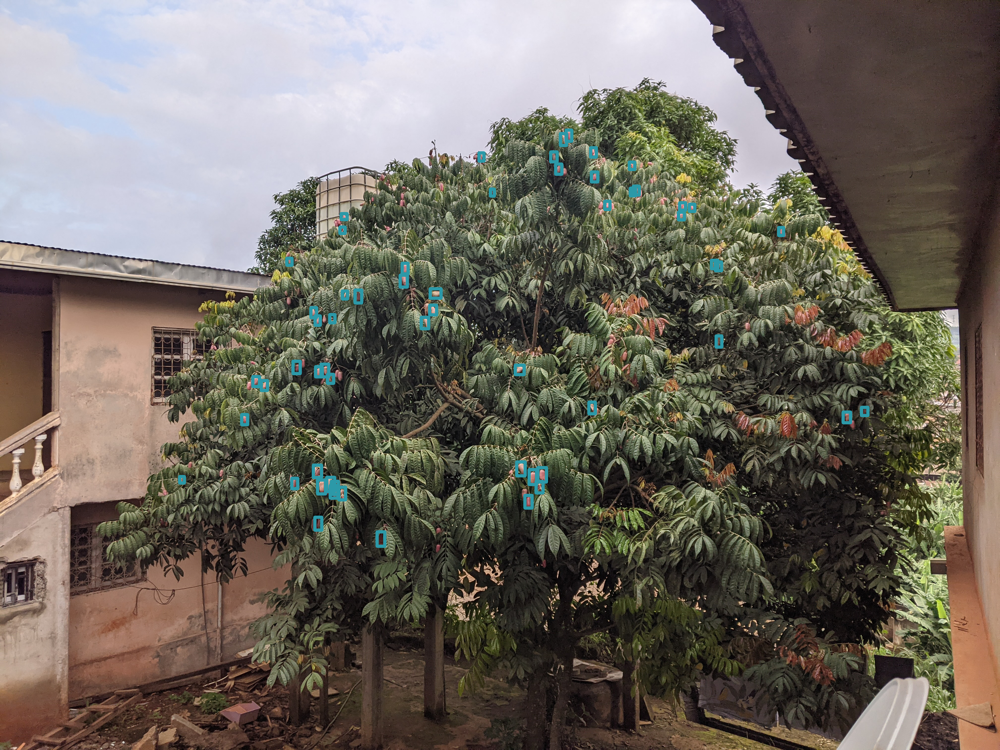

In [80]:
from IPython.display import Image

result.export_visuals(export_dir="demo_data/",hide_labels=True,hide_conf=False)
Image("demo_data/prediction_visual.png")

In [81]:
# Access the object prediction list , voyez par vous même ce qu'il renferme en le print .... N'oubliez pas votre POO ....
object_prediction_list = result.object_prediction_list
print(len(object_prediction_list))

58


## prediction avec les fenêtres glissantes de sahi

In [89]:
#Lancement de la prédiction avec sahi , ayant défini les dimensions de la fenêtre de défilement, anisi que le ration de chevauchement.
from sahi.predict import get_sliced_prediction
from sahi.utils.cv import read_image
from sahi import AutoDetectionModel


model_path="/content/gdrive/MyDrive/détection_et_comptage_safrous/checkpoints/best_yolo_11x_300epoch.pt"
detection_model = AutoDetectionModel.from_pretrained(
    model_type="ultralytics",
    model_path=model_path,
    confidence_threshold=0.2, #vous pouvez modifier cette valeur , elle varie entre 0 et 1 ,et est ajustable en fonction de la situation . La valeur généralement conseillé est 0.5
    device="cuda:0",  # or 'cuda:0 ou cpu'
)

In [90]:

#amusez vous à modifier les valeurs slice height , width , overlap heigth,width pour voir la différence , ce n'est que du code , ça ne va pas vous manger
image_path="/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé/images/test/bbb37975_A2PXL_20250525_063214845.jpg"
result = get_sliced_prediction(
    image_path,# ici on met le chemin d'accès de l'image à prédire
    detection_model,#le modèle yolov11 de détection choisi
    slice_height=32, #les dimensions de la fenêtre de défilement 256*256
    slice_width=32,
    overlap_height_ratio=0.2, # les dimensions rapports hauteur et largueur de chevauhement 0.2
    overlap_width_ratio=0.2
)



Performing prediction on 4524 slices.


In [91]:
"""from IPython.display import Image

result.export_visuals(export_dir="demo_data/",hide_labels=True,hide_conf=False)
Image("demo_data/prediction_visual.png")
"""

'from IPython.display import Image\n\nresult.export_visuals(export_dir="demo_data/",hide_labels=True,hide_conf=False)\nImage("demo_data/prediction_visual.png")\n'

In [92]:
"""#manipulation de l'objet contenant les résultats d'une prédiction pour y voir plus clair (spyez curieux , il y'a quoi ? ce n'est que du code... lol)
object_prediction_list = result.object_prediction_list
print(object_prediction_list)"""

"#manipulation de l'objet contenant les résultats d'une prédiction pour y voir plus clair (spyez curieux , il y'a quoi ? ce n'est que du code... lol)\nobject_prediction_list = result.object_prediction_list\nprint(object_prediction_list)"

In [93]:
import numpy as np
from typing import List, Dict, Any

# Définition de la structure de l'objet enrichi pour le retour
# Note: Nous retournons une liste de dictionnaires pour ajouter facilement la nouvelle clé 'area'.
EnrichedPrediction = Dict[str, Any]

def calculate_bbox_area_for_predictions(object_prediction_list: List[Any]) -> List[EnrichedPrediction]:
    """
    Calcule la superficie (aire) de la boîte englobante pour chaque prédiction
    et retourne une liste de dictionnaires enrichis.

    Args:
        object_prediction_list (List[Any]): Liste des objets ObjectPrediction
                                            (de SAHI/Ultralytics) contenant l'attribut bbox.

    Returns:
        List[EnrichedPrediction]: Liste de dictionnaires, chaque dictionnaire contenant les
                                  clés originales de la prédiction + la clé 'area'.
    """
    enriched_predictions = []

    for prediction in object_prediction_list:

        # 1. Accès et conversion des coordonnées
        # La méthode .to_xyxy() retourne les coordonnées [Xmin, Ymin, Xmax, Ymax] en pixels.
        bbox_coords = prediction.bbox.to_xyxy()

        # Le np.float64 dans votre aperçu nécessite une conversion en float standard.
        Xmin = float(bbox_coords[0])
        Ymin = float(bbox_coords[1])
        Xmax = float(bbox_coords[2])
        Ymax = float(bbox_coords[3])

        # 2. Calcul de la Superficie (Aire)
        width = Xmax - Xmin
        height = Ymax - Ymin

        # S'assurer que les dimensions sont non-négatives
        area = max(0, width) * max(0, height)

        # 3. Construction de l'Objet Enrichi

        enriched_data = {
            'bbox_xyxy': [Xmin, Ymin, Xmax, Ymax],
            'score': float(prediction.score.value), # Convertir en float standard
            'category_id': int(prediction.category.id),
            'category_name': prediction.category.name,
            # Nouvelle clé demandée
            'area': area
        }

        enriched_predictions.append(enriched_data)

    return enriched_predictions

# --- Exemple d'Utilisation ---

# ATTENTION: Vous devez exécuter ce code dans votre environnement Colab APRÈS AVOIR OBTENU
# le résultat de la prédiction (votre variable 'result').

# # Exemple d'exécution (décommenter ceci dans votre notebook):
if 'result' in locals():
     # Assurez-vous que 'result' a été obtenu avec get_sliced_prediction()
     object_prediction_list = result.object_prediction_list
     predictions_with_area = calculate_bbox_area_for_predictions(object_prediction_list)

     # Affichage du premier résultat enrichi
     if predictions_with_area:
         print("✅ Premier objet de prédiction enrichi avec la superficie (Area):")
         import json
         print(json.dumps(predictions_with_area, indent=4))
     else:
         print("La liste de prédictions est vide.")
else:
     print("Veuillez d'abord exécuter la prédiction pour obtenir la variable 'result'.")

✅ Premier objet de prédiction enrichi avec la superficie (Area):
[
    {
        "bbox_xyxy": [
            1140.3956298828125,
            949.436653137207,
            1144.7862548828125,
            954.5029277801514
        ],
        "score": 0.8031596541404724,
        "category_id": 1,
        "category_name": "safou",
        "area": 22.244112104177475
    },
    {
        "bbox_xyxy": [
            1992.0441589355469,
            2232.773223876953,
            1998.1000499725342,
            2240.977258205414
        ],
        "score": 0.7875349521636963,
        "category_id": 1,
        "category_name": "safou",
        "area": 49.682737956861274
    },
    {
        "bbox_xyxy": [
            2501.705041885376,
            2030.1960411071777,
            2508.0634336471558,
            2035.9088439941406
        ],
        "score": 0.7698032855987549,
        "category_id": 1,
        "category_name": "safou",
        "area": 36.32423881313662
    },
    {
        "bbox_xy

In [94]:
from typing import List, Dict, Any

# EnrichedPrediction est le dictionnaire de prédiction contenant la clé 'area'
EnrichedPrediction = Dict[str, Any]

def filter_predictions_by_area(predictions_with_area: List[EnrichedPrediction], area_threshold: float) -> List[EnrichedPrediction]:
    """
    Filtre la liste des prédictions enrichies pour ne conserver que celles
    dont la superficie ('area') est supérieure ou égale au seuil spécifié.

    Args:
        predictions_with_area (List[EnrichedPrediction]): Liste des dictionnaires de prédiction
                                                          incluant la clé 'area'.
        area_threshold (float): Le seuil de superficie (en pixels carrés) à dépasser.

    Returns:
        List[EnrichedPrediction]: La liste filtrée des prédictions.
    """

    # Utilisation d'une compréhension de liste pour un filtrage efficace
    filtered_list = [
        prediction
        for prediction in predictions_with_area
        if prediction['area'] >= area_threshold
    ]

    # Affichage du résumé du filtrage
    total_count = len(predictions_with_area)
    filtered_count = len(filtered_list)
    print(f"--- Résultat du Filtrage ---")
    print(f"Nombre total de prédictions : {total_count}")
    print(f"Seuil de superficie appliqué (pixels carrés) : >= {area_threshold:.2f}")
    print(f"Nombre de prédictions conservées : {filtered_count}")

    return filtered_list


SEUIL_SUPERFICIE = 100.0

# Exécuter le filtrage
large_predictions = filter_predictions_by_area(predictions_with_area, SEUIL_SUPERFICIE)

# Affichage des résultats filtrés
import json
print("\nListe des prédictions dont la superficie dépasse le seuil :")
print(json.dumps(large_predictions, indent=4))

--- Résultat du Filtrage ---
Nombre total de prédictions : 183
Seuil de superficie appliqué (pixels carrés) : >= 100.00
Nombre de prédictions conservées : 57

Liste des prédictions dont la superficie dépasse le seuil :
[
    {
        "bbox_xyxy": [
            1621.64697265625,
            1061.5732421875,
            1645.798828125,
            1104.5584716796875
        ],
        "score": 0.724802553653717,
        "category_id": 1,
        "category_name": "safou",
        "area": 1038.1730499863625
    },
    {
        "bbox_xyxy": [
            2133.244384765625,
            1893.5390625,
            2163.9755859375,
            1953.5321044921875
        ],
        "score": 0.7223529815673828,
        "category_id": 1,
        "category_name": "safou",
        "area": 1843.6582423746586
    },
    {
        "bbox_xyxy": [
            974.395751953125,
            1671.5216064453125,
            998.9505004882812,
            1712.327392578125
        ],
        "score": 0.70169

Chargement de l'image pour visualisation depuis : /content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé/images/test/bbb37975_A2PXL_20250525_063214845.jpg


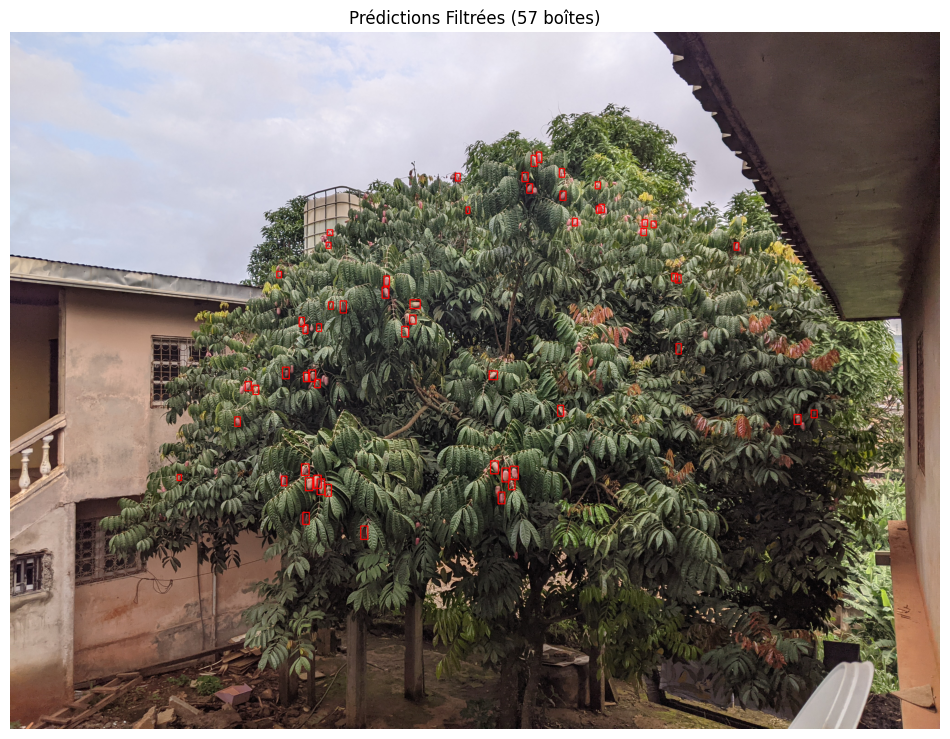


✅ Visualisation affichée dans le notebook.


In [95]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from typing import List, Dict, Any
import os

# Définition de la couleur de la boîte (en BGR pour OpenCV)
COLOR_BGR = (0, 0, 255)  # Rouge vif
LINE_THICKNESS = 3
FONT_SCALE = 0.8

# EnrichedPrediction est le dictionnaire de prédiction contenant la clé 'area'
EnrichedPrediction = Dict[str, Any]

def visualize_filtered_bboxes(filtered_predictions: List[EnrichedPrediction], image_path: str):
    """
    Charge une image, dessine les boîtes englobantes des prédictions filtrées,
    et affiche l'image résultante directement dans le notebook.

    Args:
        filtered_predictions (List[EnrichedPrediction]): Liste des dictionnaires de prédiction filtrés.
        image_path (str): Chemin d'accès complet à l'image originale.
    """
    print(f"Chargement de l'image pour visualisation depuis : {image_path}")

    # 1. Charger l'image en utilisant OpenCV
    img_bgr = cv2.imread(image_path)

    if img_bgr is None:
        print(f"❌ ERREUR: Impossible de charger l'image. Vérifiez le chemin : {image_path}")
        return

    # 2. Dessiner chaque boîte de la liste filtrée
    for i, prediction in enumerate(filtered_predictions):
        bbox_coords = prediction['bbox_xyxy']
        Xmin, Ymin, Xmax, Ymax = map(int, bbox_coords)
        #area = prediction['area']
        area=""

        # Dessiner la boîte englobante (Rectangle)
        cv2.rectangle(img_bgr, (Xmin, Ymin), (Xmax, Ymax), COLOR_BGR, LINE_THICKNESS)

        # Ajouter l'étiquette (classe + superficie)
        #label = f"Safou | Area: {area:.0f}"
        label=""

        # Définir l'emplacement du texte
        text_x = Xmin
        text_y = Ymin - 10 if Ymin - 10 > 10 else Ymax + 20

        cv2.putText(img_bgr, label, (text_x, text_y),
                    cv2.FONT_HERSHEY_SIMPLEX, FONT_SCALE, COLOR_BGR, 2, cv2.LINE_AA)


        # print(f"   > Boîte {i+1} dessinée (Area={area:.0f})")


    # 3. Conversion BGR vers RGB
    # Matplotlib utilise RGB, mais OpenCV utilise BGR. Une conversion est nécessaire.
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

    # 4. Afficher l'image dans le notebook
    plt.figure(figsize=(12, 12)) # Ajustez la taille selon vos besoins
    plt.imshow(img_rgb)
    plt.title(f"Prédictions Filtrées ({len(filtered_predictions)} boîtes)")
    plt.axis('off') # Cache les axes X et Y
    plt.show()

    print("\n✅ Visualisation affichée dans le notebook.")

# --- COMMENT UTILISER CETTE FONCTION DANS VOTRE CODE ---
# Après avoir filtré vos prédictions (par exemple, dans la variable 'large_predictions'):

# IMAGE_TEST_PATH = "/content/gdrive/MyDrive/votre_image.jpg"
visualize_filtered_bboxes(large_predictions, image_path)

## Traitement d'un lot d'images avec sahi (allez lire la doc de sahi)  https://docs.ultralytics.com/fr/guides/sahi-tiled-inference/

## **prédiction yolo+sahi et Génération fichiers de labélisations prédits du bloc test**

Pour evaluer la pertinence de sahi , nous l'utilisons sur l'ensemble de notre dataset de test de manière récurcive . Les résultats de la prédiction de chaque image est sauvegardé dans un fichier de labelisation de prédiction.txt attention à creer vous même votre dossier de fichiers_labelisation_prédits dans votre drive et à le reférencer correctement (voir la suite de cette section)

### sous fonctions

In [ ]:
# sous fonction qui ecrit dans un fichier
import os

def write_to_file(directory, filename, line):
    # Vérifier si le répertoire existe, sinon le créer
    if not os.path.exists(directory):
        os.makedirs(directory)

    # Chemin complet du fichier
    file_path = os.path.join(directory, filename)

    # Ouvrir le fichier en mode ajout (ou créer s'il n'existe pas)
    with open(file_path, 'a') as file:
            file.write(line + '\n')  # Écrire chaque ligne avec un retour à la ligne



In [ ]:
import os

# Nouvelle fonction d'écriture qui prend tout le contenu en une seule fois
def write_all_content_to_file(directory, filename, content):
    """
    Écrit tout le contenu dans le fichier et force la synchronisation avec Google Drive.
    """
    if not os.path.exists(directory):
        os.makedirs(directory)

    file_path = os.path.join(directory, filename)

    # Ouvrir le fichier en mode écriture ('w') pour créer ou écraser
    with open(file_path, 'w') as file:
        file.write(content)

        # S'assurer qu'une ligne vide n'est pas ajoutée si le contenu est vide
        if content:
            file.write('\n')

        # 1. FORCER LE VIDAGE DU BUFFER PYTHON VERS LE CACHE OS
        file.flush()

        # 2. FORCER LA SYNCHRONISATION DU CACHE OS VERS GOOGLE DRIVE
        os.fsync(file.fileno())

In [ ]:
def write_to_file_with_object_predicted_list(directory, filename, object_prediction_list):

    # 1. Collecter toutes les lignes en mémoire
    lines_to_write = []
    for prediction in object_prediction_list:
        # Assurez-vous que les coordonnées sont au format correct pour le fichier de label
        bbox = prediction.bbox.to_xyxy()
        prediction_score = prediction.score.value

        # ⚠️ NOTE: Le format standard YOLO est [class Xc Yc W H] normalisé.
        # Vous utilisez ici [class Xmin Ymin Xmax Ymax] en pixels.
        # C'est cohérent avec ce que vous avez fait plus tôt si vos prédictions sont déjà dénormalisées.
        # Vous utilisez '1' pour l'ID de classe.
        text = '1 '+f"{bbox[0]}, {bbox[1]}, {bbox[2]}, {bbox[3]}, {prediction_score}"
        lines_to_write.append(text)

    # 2. Joindre toutes les lignes en un seul bloc de texte
    all_content = "\n".join(lines_to_write)

    # 3. Appeler la fonction d'écriture unique (que nous allons modifier)
    write_all_content_to_file(directory, filename, all_content)

### execution principale

In [ ]:
#Lancement de la prédiction avec sahi , ayant défini les dimensions de la fenêtre de défilement, anisi que le ration de chevauchement.
from sahi.predict import get_sliced_prediction
from sahi.utils.cv import read_image
from sahi import AutoDetectionModel

model_path="/content/gdrive/MyDrive/détection_et_comptage_safrous/checkpoints/best_yolo_11x_300epoch.pt"
detection_model = AutoDetectionModel.from_pretrained(
    model_type="ultralytics",
    model_path=model_path,
    confidence_threshold=0.2,
    device="cuda:0",  # or 'cpu'
)


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


### **Allez maintenant creer le dossier 'label_prédit' (manuellement) dans le votre google drive , et vérifier son chemin d'accès , modifier la variable prediction_directory si necessaire...voir dans la cellule suivante**

In [ ]:
import os
import time # Ajout de la librairie time

# --- Vos chemins de répertoires ---
prediction_directory="/content/gdrive/MyDrive/détection_et_comptage_safrous/labels_prédits"
image_folder_directory="/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé/images/test"
images_folder=os.listdir(image_folder_directory)
cpt=0

print("Début du processus de prédiction et de génération de labels.")
# ----------------------------------

for image_name in images_folder:
    cpt=cpt+1
    image_path=os.path.join(image_folder_directory,image_name)
    print(f"...{cpt} Début prédiction pour l'image {image_name}")

    # Exécution de la prédiction SAHI
    result = get_sliced_prediction(
        image_path,
        detection_model,
        slice_height=32,
        slice_width=32,
        overlap_height_ratio=0.2,
        overlap_width_ratio=0.2
    )
    print("prédiction terminée")

    object_prediction_list = result.object_prediction_list

    # Génération du nom de fichier .txt
    filename=os.path.basename(image_name).split('.')[0]+'.txt'

    # Écriture du fichier de prédiction
    write_to_file_with_object_predicted_list(prediction_directory, filename, object_prediction_list)
    print(f"✅ Fichier de prédiction créé : {filename} pour l'image {image_name}")

    # 💡 AJUSTEMENT POUR LA SYNCHRONISATION GOOGLE DRIVE:
    # Introduire une courte pause après chaque écriture pour donner au système FUSE/Drive le temps de synchroniser.
    time.sleep(2)

print("Fin des prédictions et générations des fichiers de labelisation issuent des prédictions terminés")

Début du processus de prédiction et de génération de labels.
...1 Début prédiction pour l'image bbb37975_A2PXL_20250525_063214845.jpg
Performing prediction on 18135 slices.
prédiction terminée
✅ Fichier de prédiction créé : bbb37975_A2PXL_20250525_063214845.txt pour l'image bbb37975_A2PXL_20250525_063214845.jpg
...2 Début prédiction pour l'image 7c3e2554_A1PXL_20250511_061830438.jpg
Performing prediction on 18135 slices.
prédiction terminée
✅ Fichier de prédiction créé : 7c3e2554_A1PXL_20250511_061830438.txt pour l'image 7c3e2554_A1PXL_20250511_061830438.jpg
...3 Début prédiction pour l'image 3f497137_Makenene_30_Avril_2012_181.jpg
Performing prediction on 17864 slices.
prédiction terminée
✅ Fichier de prédiction créé : 3f497137_Makenene_30_Avril_2012_181.txt pour l'image 3f497137_Makenene_30_Avril_2012_181.jpg
...4 Début prédiction pour l'image fc17545b_Yaound_C3_A9_29_Avril_2012_106.jpg
Performing prediction on 17864 slices.
prédiction terminée
✅ Fichier de prédiction créé : fc17545b

## **Evaluations**

Sahi n'intègre pas un algorithme d'évaluation pour un lot d'image , nous avons donc dû ré-implementer la logique du recall , precision , mAP ... allez sur youtube , google pour mieux comprendre ces notions.... un peu de math et d'algo...

Pour l'approximation du calcul de l'aire sous une courbe , nous utilisons deux méthodes , celle des trapèzes et celle des rectangles (interpolations linaires semestre 2 3GI hahaaaaaaa , molo molo................

### Sous fonctions

In [ ]:
import os

def load_bboxs(file_path):
    """
    Charge les boîtes englobantes, gérant les séparateurs mixtes (espace et virgule).
    Format attendu par ligne : [classe] [x1],[y1],[x2],[y2]...
    """
    bboxs = []

    try:
        with open(file_path, 'r') as file:
            for line in file:
                # 1. Remplacer TOUTES les virgules par un ESPACE.
                #    Ex: '1 1695.489..., 2226.043...' devient '1 1695.489... 2226.043...'
                cleaned_line = line.replace(',', ' ').strip()

                # 2. Fractionner la ligne par les espaces (simples ou multiples)
                #    Le résultat est une liste de chaînes de nombres propres.
                parts = cleaned_line.split()

                # 3. Filtrer les parties vides et convertir en float.
                if parts:
                    try:
                        # Convertir en float. La première valeur est la classe (que vous pourriez
                        # vouloir ignorer ou garder selon le format attendu par get_IoU).
                        values = [float(p) for p in parts]
                        bboxs.append(values)
                    except ValueError:
                        # Gérer les cas où une valeur n'est pas un nombre même après nettoyage
                        # (par exemple, des caractères non désirés qui ne sont ni virgule ni espace).
                        print(f"Avertissement: Ligne ignorée en raison d'une valeur non numérique dans {file_path}: {line.strip()}")
                        continue

    except FileNotFoundError:
        print(f"Erreur: Le fichier {file_path} est introuvable.")

    return bboxs

In [ ]:
import os

def predicted_label_file_exist(prediction_directory, groundtruth_directory, groundtruth_label_file_name):
    # Construire le chemin complet pour le fichier dans chaque répertoire
    groundtruth_file_path = os.path.join(groundtruth_directory, groundtruth_label_file_name)
    predicted_file_path = os.path.join(prediction_directory, groundtruth_label_file_name)

    # Vérifier si les deux fichiers existent
    groundtruth_exists = os.path.isfile(groundtruth_file_path)
    predicted_exists = os.path.isfile(predicted_file_path)

    return groundtruth_exists and predicted_exists

# Exemple d'utilisation
#prediction_directory="/content/gdrive/MyDrive/détection_et_comptage_safrous/labels_prédits"
#groundtruth_directory="/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé/labels/test"
#groundtruth_label_file_name = 'ff4441ad_3_Safout_9.txt'  # Remplacez par le nom de votre fichier
#if not predicted_label_file_exist(prediction_directory, groundtruth_directory, groundtruth_label_file_name):
      #print("Alert: One or both files do not exist, moving on to the next image")

#else:
      #print("Good: The groundtruth and predicted files exist for the image " + groundtruth_label_file_name)



In [ ]:
def get_IoU(predicted_bbox,groundtruth_bbox):
    # Extraire les coordonnées
    xmin1, ymin1, xmax1, ymax1 = predicted_bbox[1], predicted_bbox[2], predicted_bbox[3], predicted_bbox[4]
    xmin2, ymin2, xmax2, ymax2 = groundtruth_bbox[1], groundtruth_bbox[2], groundtruth_bbox[3], groundtruth_bbox[4]

    # Calculer la largeur et la hauteur d'intersection
    intersection_width = min(xmax1, xmax2) - max(xmin1, xmin2)
    intersection_height = min(ymax1, ymax2) - max(ymin1, ymin2)

    if intersection_width <= 0 or intersection_height <= 0:
        return 0.0  # Pas d'intersection

    intersection_area = intersection_width * intersection_height

    # Calculer l'aire des boîtes
    box1_area = (xmax1 - xmin1) * (ymax1 - ymin1)
    box2_area = (xmax2 - xmin2) * (ymax2 - ymin2)

    union_area = box1_area + box2_area - intersection_area

    # Calculer l'IoU
    IoU = intersection_area / union_area if union_area > 0 else 0.0

    return IoU

# Exemple d'utilisation
#predicted_bbox =  [1,50, 100, 200,300]  # [id, xmin, ymin, xmax, ymax]
#groundtruth_bbox =[1,80,120,220,310]  # [id, xmin, ymin, xmax, ymax]

#iou = get_IoU(predicted_bbox, groundtruth_bbox)
#print(f"IoU: {iou}")

In [ ]:
def groundtruth_bbox_is_free(gt_index_to_check, gt_used_flags):
    """
    Vérifie si la boîte de vérité terrain à l'index donné est libre.

    Args:
        gt_index_to_check (int): L'index de la boîte de vérité terrain à vérifier.
        gt_used_flags (list of bool): La liste des drapeaux d'utilisation.
                                      True = Utilisé (Non libre), False = Non utilisé (Libre).
    Returns:
        bool: True si la boîte est libre, False sinon.
    """
    # On suppose que gt_used_flags[index] est True si la boîte est utilisée.
    if gt_used_flags[gt_index_to_check] == False:
        return True
    else:
        return False
    # Une version courte serait: return not gt_used_flags[gt_index_to_check]

In [ ]:
def search_matching_boxes(groundtruth_bboxs, predicted_bboxs):
    """
    Associe chaque boîte prédite à la meilleure boîte de vérité terrain non utilisée
    (si l'IoU est supérieur au seuil).

    Args:
        groundtruth_bboxs (list): Liste des boîtes de vérité terrain.
        predicted_bboxs (list): Liste des boîtes prédites.
        iou_threshold (float): Seuil IoU pour considérer une correspondance.

    Returns:
        dict: Dictionnaire contenant les correspondances et les non-correspondances.
    """

    result_search = {
        'matching_bbox': {},
        'no_matching_bbox': {}
    }

    # 1. Initialiser une liste de drapeaux à False (Non utilisé) pour les GT boxes
    gt_used_flags = [False] * len(groundtruth_bboxs)

    current_index_predicted_bbox = 0

    # BOUCLE EXTERNE : Itérer sur chaque prédiction
    for predicted_bbox in predicted_bboxs:
        IoU_max = 0
        linked_groundtruth_bbox_index = -1

        current_index_groundtruth_bbox = 0

        # BOUCLE INTERNE : Trouver le meilleur GT match pour la prédiction actuelle
        for groundtruth_bbox in groundtruth_bboxs:

            # NOTE: La fonction get_IoU(predicted_bbox, groundtruth_bbox) est définie plus haut
            IoU = get_IoU(predicted_bbox, groundtruth_bbox)

            # L'ordre de ces vérifications est essentiel :
            # 1. IoU doit dépasser le seuil.
            # 2. IoU doit être supérieur à l'IoU max actuel pour cette PREDICTION.
            # 3. La GT box doit être disponible (non utilisée).
            if IoU > 0.0 and IoU > IoU_max:

                # Vérifier si la boîte de vérité terrain à l'index actuel est LIBRE
                if not gt_used_flags[current_index_groundtruth_bbox]:
                    # Si toutes les conditions sont remplies, mettre à jour le meilleur match
                    IoU_max = IoU
                    linked_groundtruth_bbox_index = current_index_groundtruth_bbox

            current_index_groundtruth_bbox += 1

        # --- PHASE D'ASSIGNATION ET DE STOCKAGE ---

        if linked_groundtruth_bbox_index != -1:
            # TRUE POSITIVE (TP): Une correspondance valide (au-dessus du seuil et unique) a été trouvée

            # 2. MARQUER la GT box comme utilisée (Ceci assure l'unicité !)
            gt_used_flags[linked_groundtruth_bbox_index] = True

            # 3. Enregistrer les résultats de la correspondance
            result_search['matching_bbox'][current_index_predicted_bbox] = {
                'groundtruth_coords': groundtruth_bboxs[linked_groundtruth_bbox_index],
                'predicted_coords': predicted_bbox,
                'IoU': IoU_max
            }
        else:
            # FALSE POSITIVE (FP): Aucune GT box non utilisée n'a pu être associée (même si IoU > 0)

            # Enregistrer la prédiction comme n'ayant pas de correspondance
            result_search['no_matching_bbox'][current_index_predicted_bbox] = {
                'predicted_coords': predicted_bbox
            }

        current_index_predicted_bbox += 1

    # NOTE: Les False Negatives (FN) sont implicites: ce sont les GT boxes dans gt_used_flags qui sont restées à False.
    return result_search

In [ ]:
def count_metrics(all_matching_results, total_gt_boxes, iou_threshold):
    """
    Calcule les True Positives (TP), False Positives (FP) et False Negatives (FN)
    en filtrant les résultats de matching par l'IoU_treshold.

    Args:
        all_matching_results (dict): Dictionnaire agrégé de search_best_unique_matches.
        total_gt_boxes (int): Nombre total de boîtes de vérité terrain dans tout le jeu de données de test.
        iou_threshold (float): Le seuil IoU à appliquer pour définir un TP.

    Returns:
        tuple: (total_tp, total_fp, total_fn)
    """
    total_tp = 0
    total_fp = 0

    for image_name, result in all_matching_results.items():
        # --- 1. Calcul des True Positives (TP) ---
        # Un 'matching_bbox' est un TP seulement si son IoU max atteint le SEUIL actuel
        for pred_index, match_data in result.get('matching_bbox', {}).items():
            if match_data['IoU'] >= iou_threshold:
                total_tp += 1
            else:
                # Si l'IoU était le meilleur et unique mais est inférieur au seuil
                # Il devient un False Positive (FP), car la prédiction est mauvaise
                total_fp += 1

        # --- 2. Calcul des False Positives (FP) ---
        # Les 'no_matching_bbox' sont des FP car elles n'ont pas trouvé de correspondance unique
        # au-dessus du seuil de 0.0 (IoU_max < 0.0, ce qui n'arrive jamais) ou
        # parce qu'elles n'ont pas trouvé de GT box libre (même si IoU > 0).
        # Celles-ci sont TOUJOURS des FP, car elles n'ont pas trouvé un match initial.
        total_fp += len(result.get('no_matching_bbox', {}))

    # --- 3. Calcul des False Negatives (FN) ---
    # FN = Le nombre de boîtes GT qui n'ont PAS été assignées à un TP valide.
    total_fn = total_gt_boxes - total_tp

    return total_tp, total_fp, total_fn

In [ ]:
def sort_bboxs_by_last_element(bboxs_list):
    """
    Trie une liste de boîtes englobantes (listes de nombres) par ordre
    décroissant de leur dernier élément (généralement le score/la confiance).

    Args:
        bboxs_list (list): Liste des boîtes englobantes (ex: [[classe, x1, y1, x2, y2, score], ...])

    Returns:
        list: La liste triée.
    """
    # La clé de tri (key) prend le dernier élément de chaque sous-liste (x[-1]).
    # reverse=True garantit un ordre décroissant.
    sorted_list = sorted(
        bboxs_list,
        key=lambda x: x[-1],
        reverse=True
    )
    return sorted_list

In [ ]:
import numpy as np
def calculate_interpolated_ap(precision_list, recall_list):
    """
    Calcule l'Average Precision (AP) en utilisant la méthode d'interpolation à tous les points.

    Args:
        precision_list (np.array): Précision cumulative pour chaque seuil de confiance.
        recall_list (np.array): Rappel cumulatif pour chaque seuil de confiance.

    Returns:
        float: La valeur de l'AP interpolée.
    """
    # 1. Ajouter les points de départ et de fin (Rappel 0, Rappel 1)
    # R: [0, r1, r2, ..., 1]
    # P: [1, p1, p2, ..., 0]
    recall = np.concatenate(([0.0], recall_list, [1.0]))
    precision = np.concatenate(([1.0], precision_list, [0.0]))

    # 2. Interpolation (Calcul de la Précision Maximale pour chaque niveau de Rappel)
    # L'interpolation garantit que la Précision est une fonction non croissante du Rappel
    # (P_interp(r) = max_{r' >= r} P(r'))

    # Nous parcourons la liste des précisions à l'envers
    for i in range(len(precision) - 2, -1, -1):
        precision[i] = np.maximum(precision[i], precision[i + 1])

    # 3. Calcul de l'Aire (Somme des rectangles)
    # L'aire est calculée par la somme de la largeur du Rappel (delta_r)
    # multipliée par la Précision interpolée.

    # Largeur des segments du Rappel
    delta_recall = recall[1:] - recall[:-1]

    # AP = Somme (Précision interpolée * Largeur du Rappel)
    ap_value = np.sum(precision[:-1] * delta_recall)

    return ap_value

# --- Comment l'utiliser dans votre fonction get_AP ---
# ... (Après avoir calculé precision_list et recall_list) ...


In [ ]:
import numpy as np

def get_AP(groundtruth_bboxs, predicted_bboxs, IoU_treshold):
    """
    Calcule l'Average Precision (AP) pour une seule classe et un seul seuil IoU.

    Args:
        groundtruth_bboxs (list): Liste des boîtes de vérité terrain.
        predicted_bboxs (list): Liste des boîtes prédites (avec score en dernier élément).
        IoU_treshold (float): Seuil IoU pour considérer un match.

    Returns:
        float: La valeur de l'AP.
    """

    # 1. Trier les prédictions par score décroissant (ESSENTIEL pour la courbe P-R)
    # On suppose que 'sort_bboxs_by_last_element' est définie et fonctionne correctement.
    sorted_predicted_bboxs = sort_bboxs_by_last_element(predicted_bboxs)

    # Initialisation des compteurs et listes
    len_groundtruth_bboxs = len(groundtruth_bboxs)
    tp_list = [] # Liste pour stocker 1 (TP) ou 0 (FP) pour chaque prédiction

    # Set pour suivre les ID des vérités terrain déjà matchées (Règle d'Unicité)
    matched_gt_ids = set()

    print(f"Nombre de vérités terrain (FN max) : {len_groundtruth_bboxs}")

    # 2. Boucle à travers les prédictions triées
    for predicted_bbox in sorted_predicted_bboxs:

        # Initialisation de la recherche du meilleur match
        IoU_max = 0
        best_gt_index = -1

        # Trouve le meilleur match parmi les GTs
        for idx, groundtruth_bbox in enumerate(groundtruth_bboxs):

            # ⚠️ ASSUMPTION: Chaque GT box dans la liste est unique et possède un ID ou un index unique (ici, 'idx').

            IoU = get_IoU(predicted_bbox, groundtruth_bbox)

            if IoU > IoU_max:
                IoU_max = IoU
                best_gt_index = idx # Stocke l'index du meilleur match potentiel

        # 3. Détermination du TP ou FP

        # Condition pour être un TP : IoU > seuil ET la GT n'a jamais été matchée.
        if IoU_max >= IoU_treshold:

            # Vérifie si cette vérité terrain (GT) a déjà été matchée
            if best_gt_index not in matched_gt_ids:
                # C'est un True Positive (TP) : match trouvé, et GT est disponible
                tp_list.append(1)
                matched_gt_ids.add(best_gt_index) # Marque cette GT comme utilisée
            else:
                # C'est un False Positive (FP) : match trouvé, mais la GT a déjà été prise par une meilleure prédiction
                tp_list.append(0)
        else:
            # C'est un False Positive (FP) : IoU trop faible
            tp_list.append(0)

    # 4. Calcul des listes cumulatives de Précision et Rappel

    # Cumulatifs
    tp_cumulatif = np.cumsum(tp_list)
    fp_cumulatif = np.cumsum([1 - tp for tp in tp_list]) # FP = 1 - TP

    # Précision et Rappel pour chaque point
    precision_list = tp_cumulatif / (tp_cumulatif + fp_cumulatif)
    recall_list = tp_cumulatif / len_groundtruth_bboxs # Rappel max est 1.0 (ou le nombre de GTs)

    # 5. Calcul de l'AP (méthode du trapèze standard)

    # ⚠️ NOTE: L'AP standard requiert une interpolation de la courbe.
    # Pour un calcul rapide, nous utilisons la méthode des trapèzes,
    # en s'assurant que les listes sont passées dans le bon ordre (recall comme x-axis).

    # np.trapz(y, x)
    ap_value = np.trapezoid(precision_list, recall_list)

# Convertir les listes Python en tableaux NumPy pour la fonction
    precision_array = np.array(precision_list)
    recall_array = np.array(recall_list)

    ap_value2 = calculate_interpolated_ap(precision_list, recall_list)


    print("✅ Calcul de l'AP terminé.")

    return ap_value ,ap_value2

In [ ]:
# Fonction utilitaire pour agréger les TP et FP sur toutes les images


def get_precision(total_tp, total_fp):
    """Calcule la Précision agrégée (sur toutes les images)."""
    if (total_tp + total_fp) == 0:
        return 0.0
    return total_tp / (total_tp + total_fp)

def get_recall(total_tp, total_fn):
    """Calcule le Rappel agrégé (sur toutes les images)."""
    if (total_tp + total_fn) == 0:
        return 0.0
    return total_tp / (total_tp + total_fn)


def get_iou_precision_recall_list(all_matching_results, total_gt_boxes):

  iou_threshold=0.0
  iou_list=[]
  precision_list=[]
  recall_list=[]


  while (iou_threshold<=0.9) :

    TP, FP, FN = count_metrics(result_matching_boxes, total_gt_boxes, IoU_treshold)
    precision = get_precision(TP, FP)
    recall = get_recall(TP, FN)
    iou_list.append(iou_threshold)
    precision_list.append(precision)
    recall_list.append(recall)
    iou_threshold=iou_threshold+0.01


  return iou_list, precision_list, recall_list




In [ ]:
from PIL import Image

def get_image_dimensions(image_path):
    """
    Retourne la largeur et la hauteur d'une image.

    Args:
        image_path (str): Le chemin d'accès vers l'image.

    Returns:
        tuple: (width, height) de l'image.
    """
    with Image.open(image_path) as img:
        width, height = img.size
    return width, height

''' Exemple d'utilisation
image_path = '/content/gdrive/MyDrive/safou2/safou2/images/test/02bed01f_A5PXL_20250525_064315239.MP.jpg'  # Remplacez par le chemin de votre image
width, height = get_image_dimensions(image_path)
print(f"Largeur: {width}, Hauteur: {height}")'''

' Exemple d\'utilisation\nimage_path = \'/content/gdrive/MyDrive/safou2/safou2/images/test/02bed01f_A5PXL_20250525_064315239.MP.jpg\'  # Remplacez par le chemin de votre image\nwidth, height = get_image_dimensions(image_path)\nprint(f"Largeur: {width}, Hauteur: {height}")'

In [ ]:

def denormalize_bbox(normalize_groundtruth_bboxs,image_width,image_height):
 bboxs_denormalize=[]
 for normalize_groundtruth_bbox in normalize_groundtruth_bboxs :
  bbox_denormalize=[]

  label_id=normalize_groundtruth_bbox[0]
  Xc_norm=normalize_groundtruth_bbox[1]
  Yc_norm=normalize_groundtruth_bbox[2]
  W_norm=normalize_groundtruth_bbox[3]
  H_norm=normalize_groundtruth_bbox[4]

  label=label_id
  Xc=Xc_norm*image_width
  Yc=Yc_norm*image_height
  W=W_norm*image_width
  H=H_norm*image_height

  Xmin=Xc-W/2
  Ymin=Yc-H/2
  Xmax=Xc+W/2
  Ymax=Yc+H/2

  bbox_denormalize.append(label)
  bbox_denormalize.append(Xmin)
  bbox_denormalize.append(Ymin)
  bbox_denormalize.append(Xmax)
  bbox_denormalize.append(Ymax)

  bboxs_denormalize.append(bbox_denormalize)
 return bboxs_denormalize


### fonction principale evaluation

In [ ]:
#TOUJOURS VERIFIER LES CHEMINS D'ACCES ET MODIFIER SI NECESSAIRE
prediction_directory="/content/gdrive/MyDrive/détection_et_comptage_safrous/labels_prédits"
groundtruth_directory="/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé/labels/test"
image_folder_directory="/content/gdrive/MyDrive/détection_et_comptage_safrous/safou_labelisé/safou_labelisé/images/test" # Added this line
predicted_labels_files_names=os.listdir(prediction_directory)
groundtruth_labels_files_names=os.listdir(groundtruth_directory)



result_matching_boxes={}
IoU_treshold=0.5
TP=0
FP=0
FN=0
total_gt_boxes=0
total_predicted_boxes=0
mAP=0
all_groundthruth_bbox=[]
all_predicted_bbox=[]
id=1


print("Step1 : computing matching and no matching bounding boxes with IoU measurement ")
for groundtruth_label_file_name in groundtruth_labels_files_names:
    if not predicted_label_file_exist(prediction_directory, groundtruth_directory, groundtruth_label_file_name):
      #print("Alert: One or both files do not exist " + groundtruth_label_file_name+" we are skipping it voluntary")
      continue

      #print("Good: The groundtruth and predicted files exist for the image " + groundtruth_label_file_name)

    #Chargement des bboxs prédits à partir des fichiers générés plus haut
    predicted_bboxs=load_bboxs(os.path.join(prediction_directory,groundtruth_label_file_name)) #predicted_labels_files_name as the exact same value with groundtruth_label_file_name

    for predicted_bbox in predicted_bboxs:
      predicted_bbox.append(id)
      all_predicted_bbox.append(predicted_bbox)
      id+=1

    #Chargement des bboxs groundtruth à partir des fichiers générés plus haut
    #Ici on dénormalise car les bbox vrais sont sous forme normalisés
    # Construct the corresponding image path
    image_name = groundtruth_label_file_name.replace('.txt', '.jpg') # Assuming images are .jpg
    image_path = os.path.join(image_folder_directory, image_name)

    image_width,image_height=get_image_dimensions(image_path) # Modified this line
    normalize_groundtruth_bboxs=load_bboxs(os.path.join(groundtruth_directory,groundtruth_label_file_name))

    groundtruth_bboxs=denormalize_bbox(normalize_groundtruth_bboxs,image_width,image_height)
    #print("denormalize bbox length"+str(len(groundtruth_bboxs)))
    for groundtruth_bbox in groundtruth_bboxs:
      groundtruth_bbox.append(id)
      all_groundthruth_bbox.append(groundtruth_bbox)
      id+=1

    #print(groundtruth_bboxs)
    #print(predicted_bboxs)
    #print("normalize bbox length"+str(len(normalize_groundtruth_bboxs)))
    #print("denormalize bbox length"+str(len(groundtruth_bboxs)))
    total_gt_boxes += len(groundtruth_bboxs) #for the FN
    total_predicted_boxes+=len(predicted_bboxs)
    #print("total: "+str(total_gt_boxes))
    #print('groundtruth and predicted boxes of the image '+groundtruth_label_file_name+' successfuly load')
    result_matching_boxes[groundtruth_label_file_name]= search_matching_boxes(groundtruth_bboxs,predicted_bboxs)
    #print("matching boxes and no_matching boxes successfully calculated for this image")
    #print("end this computing")

print('Step2: Computing of precision, recall and mAP-50 as evaluation metric of this yolo+sahi model')

TP, FP, FN = count_metrics(result_matching_boxes, total_gt_boxes, IoU_treshold)
precision=get_precision(TP, FP)
recall= get_recall(TP, FN)
#iou_list,precision_list,recall_list=get_iou_precision_recall_list(result_matching_boxes, total_gt_boxes)
#print("iou_list "+str(iou_list))
#print("precision_list "+str(precision_list))
#print("recall_list "+str(recall_list))
AP1 ,AP2=get_AP(all_groundthruth_bbox, all_predicted_bbox,IoU_treshold) #ici mAP=AP car m=1=safou on n'a qu'une seule classe .


print(f"precision: {precision}; recall: {recall}")
print(f"AP1 avec la méthode des trapèze: {AP1};AP2 avec la méthode des rectangles: {AP2}")


Step1 : computing matching and no matching bounding boxes with IoU measurement 
Step2: Computing of precision, recall and mAP-50 as evaluation metric of this yolo+sahi model
Nombre de vérités terrain (FN max) : 2785
✅ Calcul de l'AP terminé.
precision: 0.5712356515867657; recall: 0.303770197486535


### visualisation des données

Nous visualisons dans le même espace les résultats issuent de l'utilisation de sahi avec les données de vérité connus ( bbox labelisés de départ) . Ceci nous permet d'apprecier visuellement les résultats. Nous affichons ici les centres des bboxs prédits (croix rouge) et les centres des bboxs connus(Rond vert)

une croix et un rond qui se chevauchent , cela veut dire que la boite prédicte correspond à celle labelisé donc un vrai positif
si une croix se trouve à côté d'un rond , il semblerai que on ait un vrai positif mais que la région n'ait pas été correctement ou totalement prédicte

si une croix se trouve seul ,il s'agit d'un faux positif
si un rond se trouve seul , il s'agit d'un faux négatif

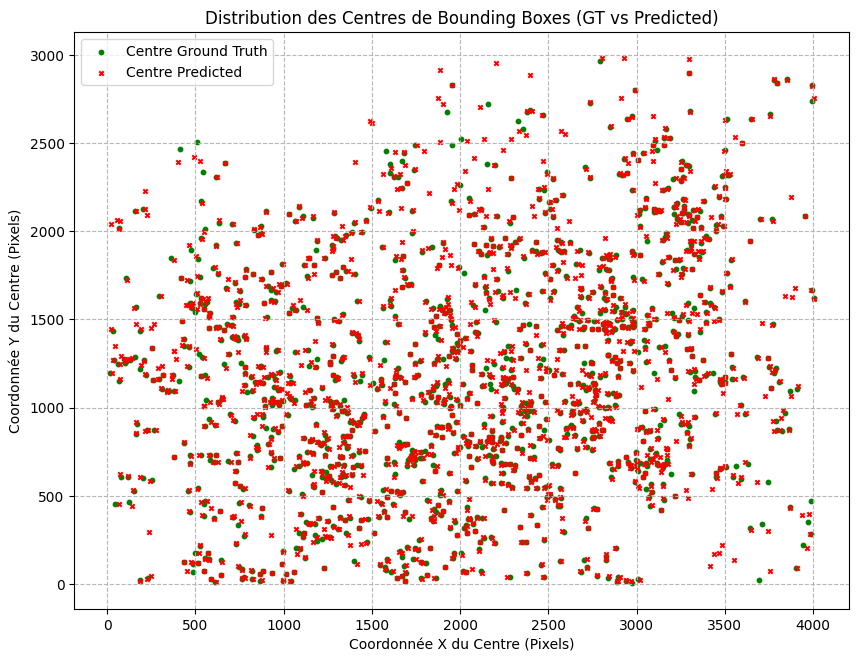

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def visualize_center_points_abstract(all_matching_results):
    """
    Visualise les centres de toutes les boîtes englobantes (Ground Truth et Predicted)
    dans un espace graphique abstrait (plan X-Y).

    Args:
        all_matching_results (dict): Dictionnaire agrégé contenant les résultats de matching.
    """
    fig, ax = plt.subplots(1, figsize=(10, 10))
    ax.set_title("Distribution des Centres de Bounding Boxes (GT vs Predicted)")
    ax.set_xlabel("Coordonnée X du Centre (Pixels)")
    ax.set_ylabel("Coordonnée Y du Centre (Pixels)")

    # Listes pour stocker tous les points
    gt_centers_x = []
    gt_centers_y = []
    pred_centers_x = []
    pred_centers_y = []

    # Parcourir les résultats de toutes les images
    for image_name, result in all_matching_results.items():

        # --- 1. Récupérer les centres GT ---
        # Les GT sont stockées dans les 'matching_bbox'
        for match_data in result.get('matching_bbox', {}).values():
            # Coordonnées PIXEL [Xmin, Ymin, Xmax, Ymax]
            gt_coords = match_data['groundtruth_coords']
            Xmin, Ymin, Xmax, Ymax = gt_coords[1], gt_coords[2], gt_coords[3], gt_coords[4]

            # Calcul du centre (Xc, Yc)
            Xc = (Xmin + Xmax) / 2
            Yc = (Ymin + Ymax) / 2

            gt_centers_x.append(Xc)
            gt_centers_y.append(Yc)

        # --- 2. Récupérer les centres Predicted (Matchés et Non Matchés) ---

        # 2.1 Predicted boxes qui ont trouvé un match unique
        for match_data in result.get('matching_bbox', {}).values():
            pred_coords = match_data['predicted_coords']
            Xmin, Ymin, Xmax, Ymax = pred_coords[1], pred_coords[2], pred_coords[3], pred_coords[4]

            Xc = (Xmin + Xmax) / 2
            Yc = (Ymin + Ymax) / 2

            pred_centers_x.append(Xc)
            pred_centers_y.append(Yc)

        # 2.2 Predicted boxes qui n'ont PAS trouvé de match unique (False Positives)
        for no_match_data in result.get('no_matching_bbox', {}).values():
            pred_coords = no_match_data['predicted_coords']
            Xmin, Ymin, Xmax, Ymax = pred_coords[1], pred_coords[2], pred_coords[3], pred_coords[4]

            Xc = (Xmin + Xmax) / 2
            Yc = (Ymin + Ymax) / 2

            pred_centers_x.append(Xc)
            pred_centers_y.append(Yc)

    # --- 3. Tracer les points ---

    # Tracer les centres Ground Truth (Vert)
    ax.scatter(gt_centers_x, gt_centers_y, color='g', marker='o', s=10, label='Centre Ground Truth')

    # Tracer les centres Predicted (Rouge)
    ax.scatter(pred_centers_x, pred_centers_y, color='r', marker='x', s=10, label='Centre Predicted')

    # Finalisation du graphique
    ax.legend()
    ax.autoscale_view()
    #plt.gca().invert_yaxis() # Conventionnellement, l'axe Y des pixels est inversé
    plt.gca().set_aspect('equal', adjustable='box')
    plt.grid(True, linestyle='--', alpha=0.9)
    plt.show()

# --- EXÉCUTION DE LA VISUALISATION ---

# ⚠️ Assurez-vous que 'result_matching_boxes' est la variable globale remplie.
if result_matching_boxes:
    visualize_center_points_abstract(result_matching_boxes)
else:
    print("Veuillez d'abord exécuter l'étape de matching (search_best_unique_matches) pour remplir result_matching_boxes.")